In [1]:
import argparse
import os
import sys
import numpy as np

import torch
import matplotlib.pyplot as plt     # type: ignore

things_stim_path = '/user_data/mmhender/stimuli/things/'

sys.path.append('/user_data/mmhender/featsynth/code/utils')
sys.path.append('/user_data/mmhender/featsynth/texture_synthesis/code/')
import things_utils
import utilities

import pandas as pd
import PIL
import time

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

/home/mmhender/imstat_env/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


cuda


In [3]:
fn = '/user_data/mmhender/featsynth/code/make_expt_designs/expt1_categ_info.npy'
info = np.load(fn, allow_pickle=True).item()
categ_names = info['super_names']
n_categ = len(categ_names)
concept_names_subsample = [info['basic_names'][info['super_inds_long']==si] \
                          for si in range(n_categ)]


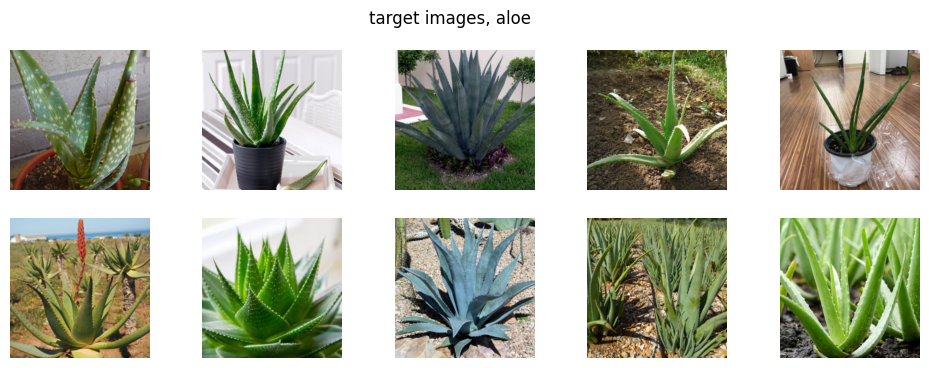

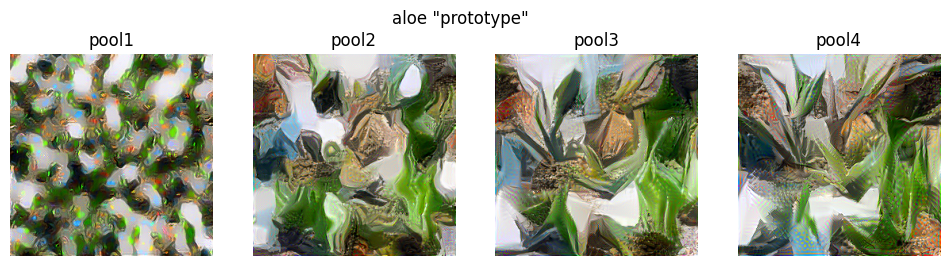

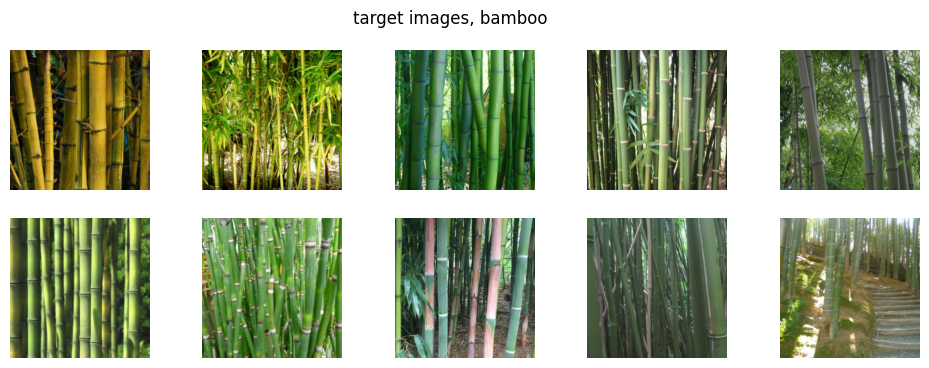

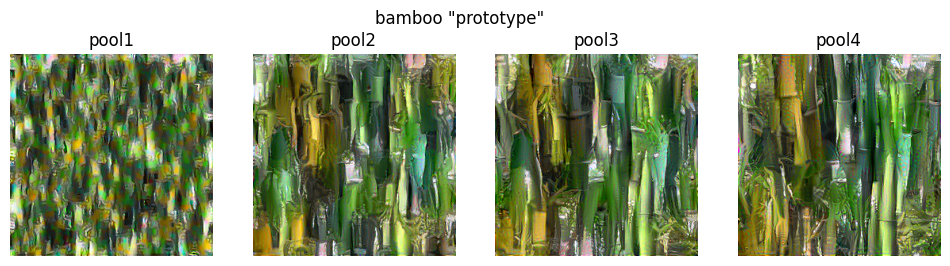

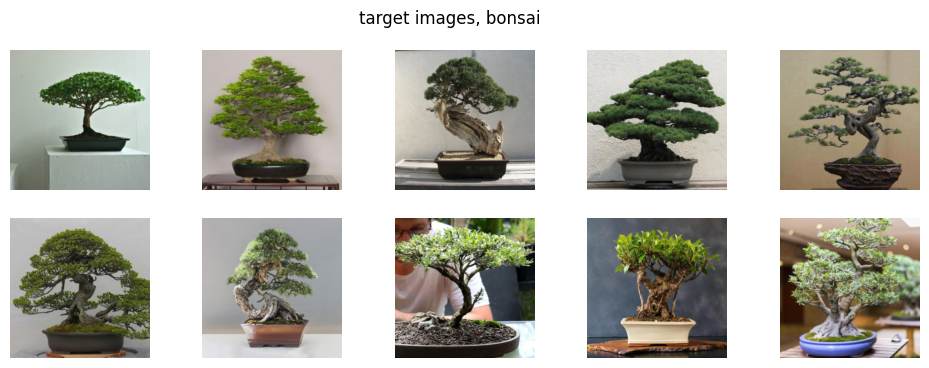

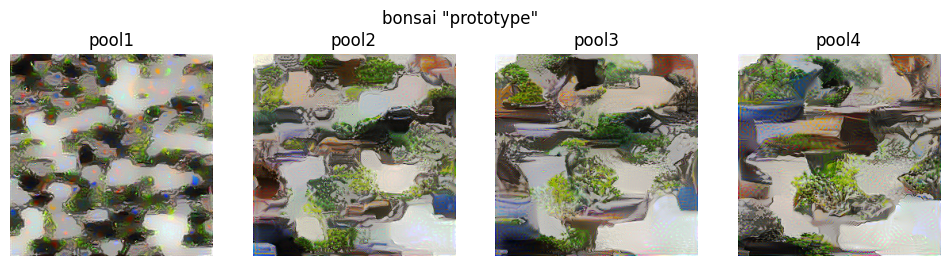

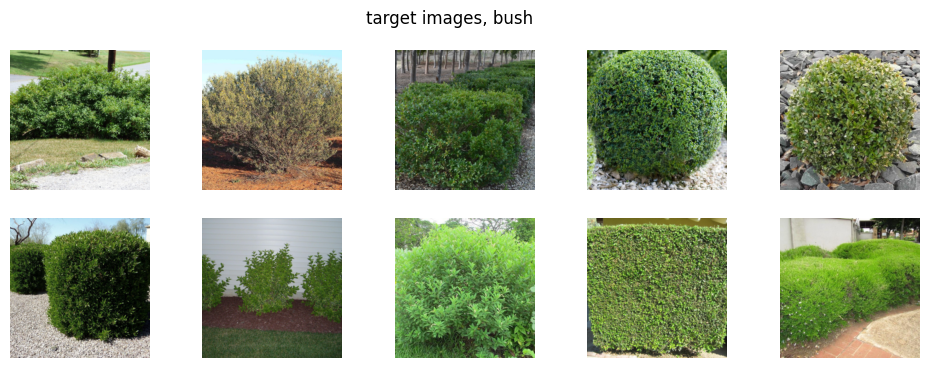

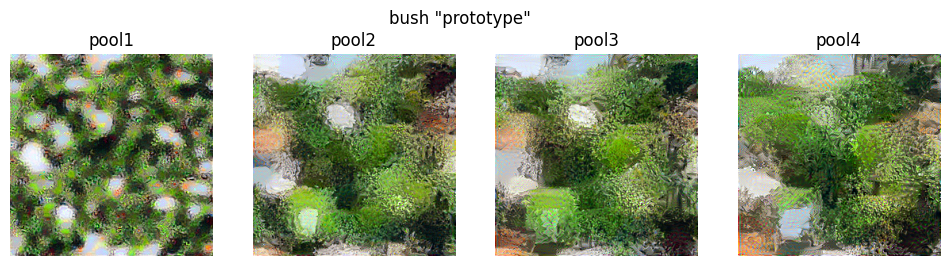

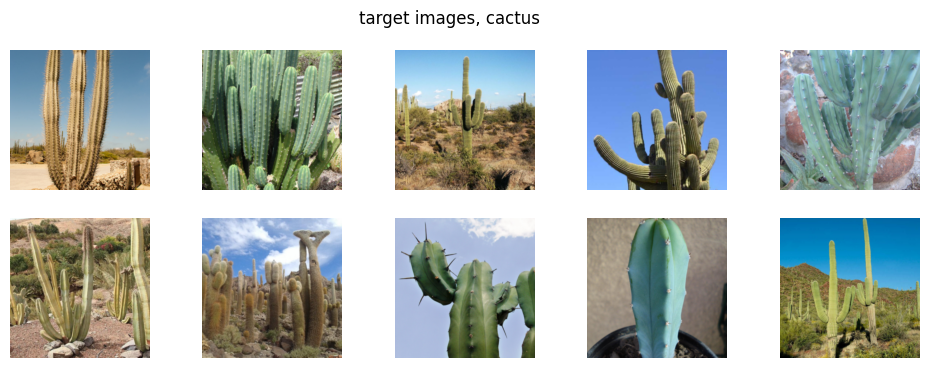

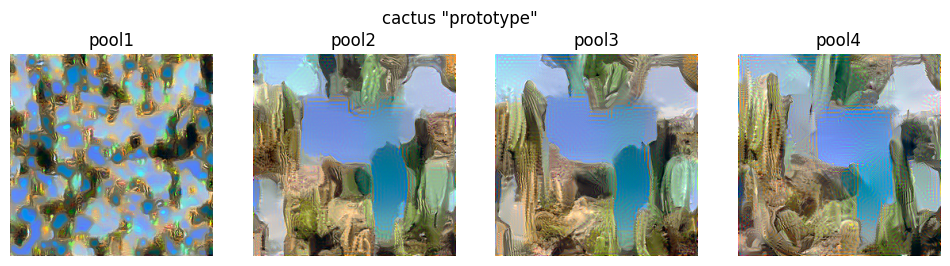

In [7]:
ca = 17;

save_stim_path = '/user_data/mmhender/stimuli/featsynth/images_v1_basic_prototypes'
 
for co in range(5):

    conc = concept_names_subsample[ca][co]

    plt.figure(figsize=(12,4))

    n_ims_combine = 10;
    for ii in range(n_ims_combine):

        fn = things_utils.get_filename(categ_names[ca], conc, ii)

        im_orig = utilities.preprocess_image_tosave(utilities.load_image(fn))

        plt.subplot(2, 5, ii+1)

        plt.imshow(im_orig)
        plt.axis('off')

    plt.suptitle('target images, %s'%(conc));

    plt.figure(figsize=(12,3))

    out_dir = os.path.join(save_stim_path, '%s_prototype'%(conc))
    layers_plot = ['pool1','pool2','pool3','pool4']

    for ll in range(4):

        plt.subplot(1,4,ll+1)
        fn = os.path.join(out_dir, 'scramble_upto_%s.png'%(layers_plot[ll]))
        im = PIL.Image.open(fn)
        plt.imshow(im)
        plt.axis('off')
        plt.title('%s'%(layers_plot[ll]))

    plt.suptitle('%s "prototype"'%(conc));

#### superord results

/home/mmhender/imstat_env/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


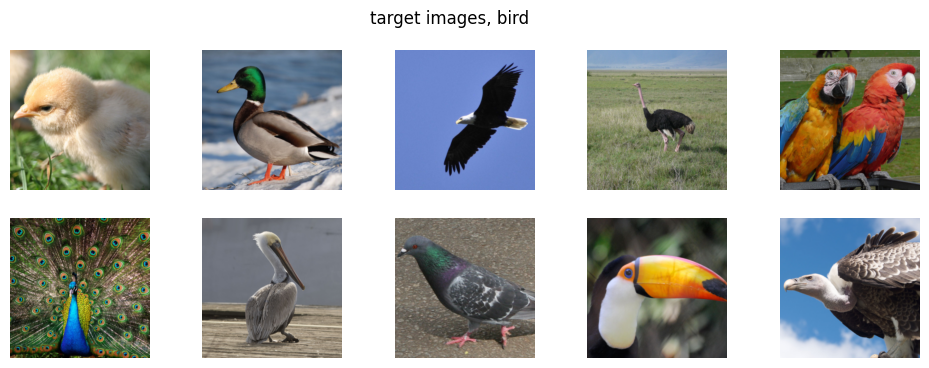

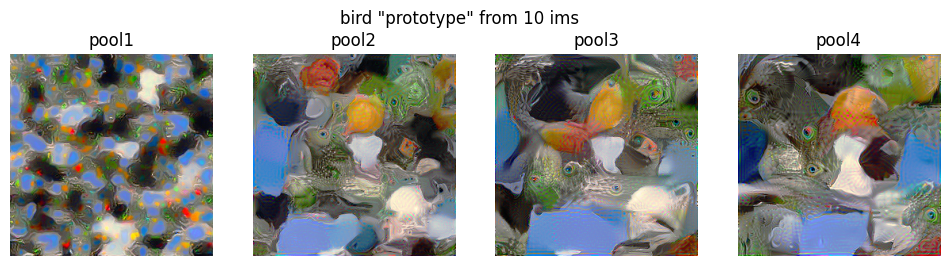

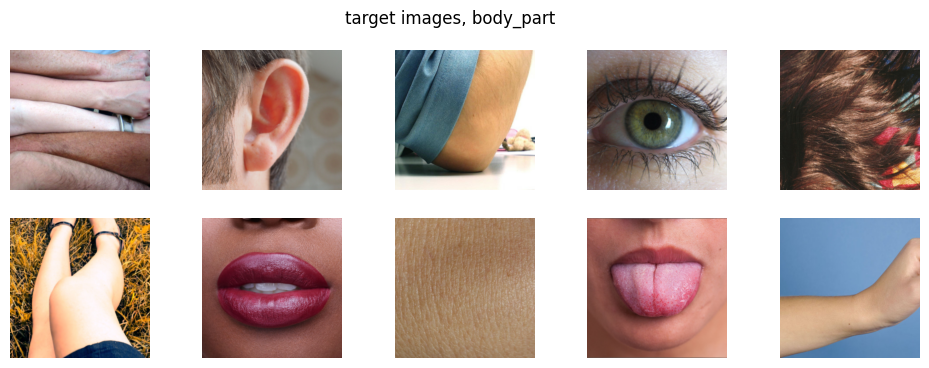

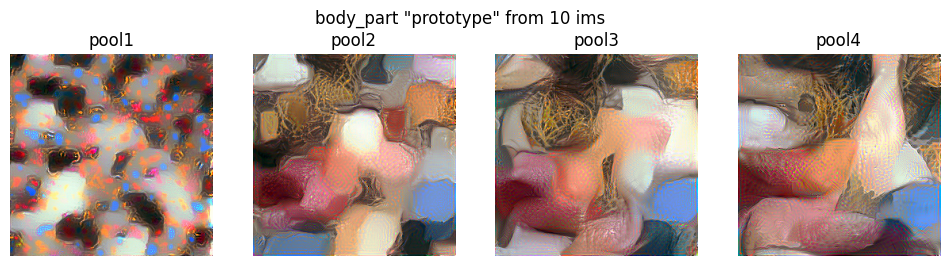

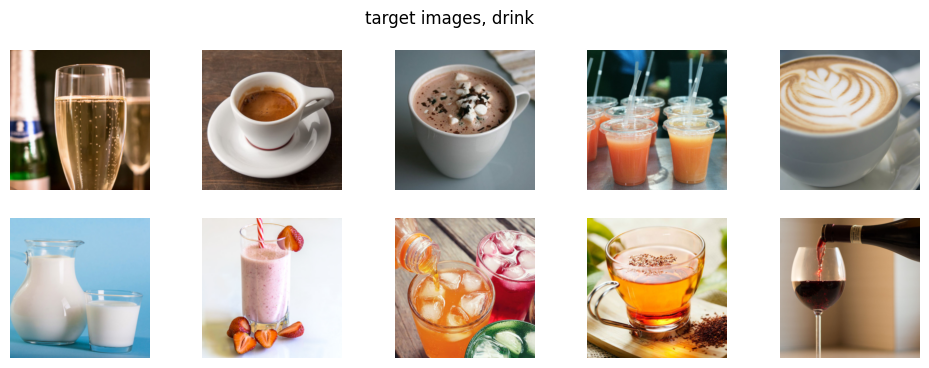

...

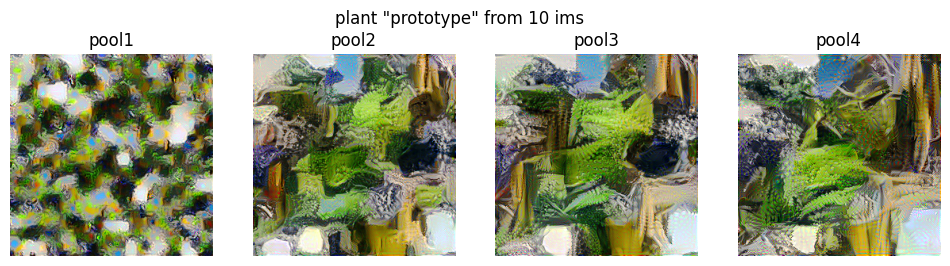

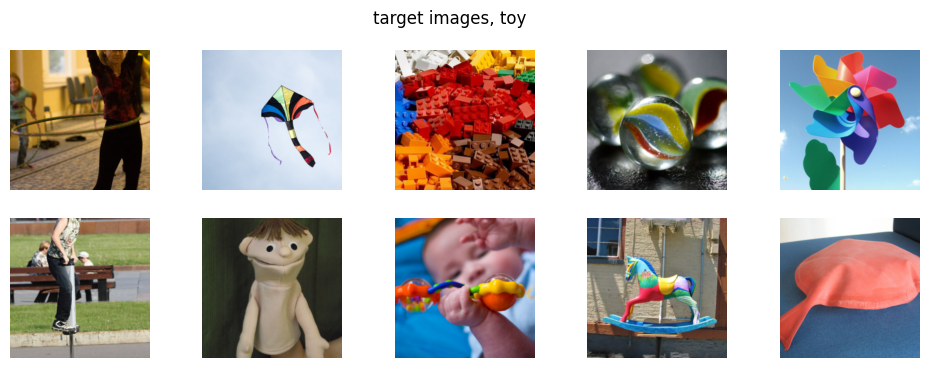

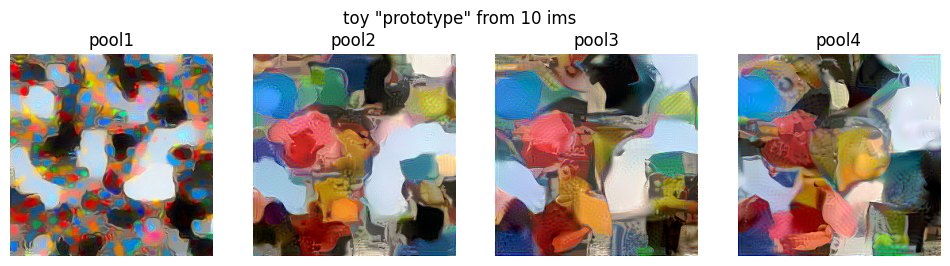

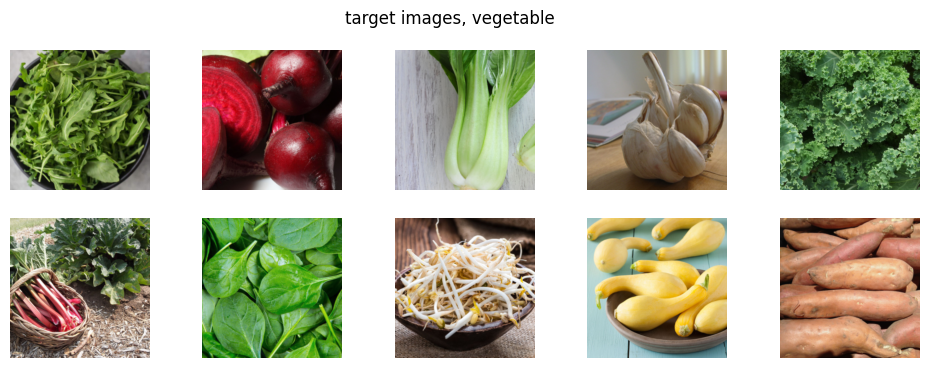

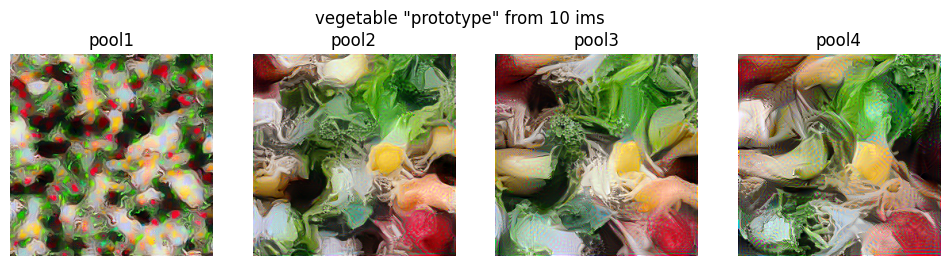

In [5]:
save_stim_path = '/user_data/mmhender/stimuli/featsynth/images_v1_superord_prototypes'

n_ims_combine = 10;
    
    
for ca in np.arange(n_categ):
    
    categ = categ_names[ca]
    
    
    exemplars_combine = np.arange(1)
    
    
    target_image_filenames = np.concatenate(\
                                    [[things_utils.get_filename(categ, conc, ii) \
                                      for ii in exemplars_combine] \
                                      for conc in concept_names_subsample[ca]], \
                                        axis=0)
    
    plt.figure(figsize=(12,4))
    
    n_ims_plot = 10;
    for ii in range(n_ims_plot):
    
        fn = target_image_filenames[ii]
    
        im_orig = utilities.preprocess_image_tosave(utilities.load_image(fn))
    
        plt.subplot(2,5, ii+1)
    
        plt.imshow(im_orig)
        plt.axis('off')
    
    plt.suptitle('target images, %s'%(categ));
           
    plt.figure(figsize=(12,3))

    out_dir = os.path.join(save_stim_path, '%s_prototype_%dims'%(categ, n_ims_combine))
    layers_plot = ['pool1','pool2','pool3','pool4']

    for ll in range(4):

        plt.subplot(1,4,ll+1)
        fn = os.path.join(out_dir, 'scramble_upto_%s.png'%(layers_plot[ll]))
        im = PIL.Image.open(fn)
        plt.imshow(im)
        plt.axis('off')
        plt.title('%s'%(layers_plot[ll]))

    plt.suptitle('%s "prototype" from %d ims'%(categ, n_ims_combine));